In [1]:
%config InlineBackend.figure_format='retina'

In [2]:
from copy import deepcopy
import warnings
warnings.filterwarnings("ignore")

In [4]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from tensorflow import keras

# Загрузка данных

## Сенсоры

In [5]:
from datetime import datetime

Data = pd.read_csv("../Probe_Data/SensorsData_March.csv", index_col=0).iloc[::30, :-5]
Data.index = np.array(
    ([datetime.strptime(d[:-7], '%d.%m.%Y %H:%M:%S') for d in Data.index]),
    dtype='datetime64[ns]')

## Остановки

In [6]:
# StopLogs data

stops_data = pd.read_csv("../Probe_Data/Jan_to_Jun_StopLogs.csv")
stops_data['start_datetime'] = stops_data.start_datetime.astype('datetime64[ns]')
stops_data['end_datetime'] = stops_data.end_datetime.astype('datetime64[ns]')

In [7]:
March_Stops = stops_data[(stops_data.start_datetime >= "2020-03-01")
                         & (stops_data.end_datetime <= "2020-03-25")]

March_Stops.sort_values(by='start_datetime', inplace=True)

## Таргет

In [8]:
# Берем таргет из журнальных данных

Data['target'] = 0
Data['target_dscr'] = "Норма"

for start, end, dscr in March_Stops[np.invert(March_Stops.description.isin([
        "Технологические плановые : Межплавочный период",
        ]))]\
        [['start_datetime', 'end_datetime', 'description']].values:
    
    Data['target'][(Data.index >= start) & (Data.index <= end)] = 1
    Data['target_dscr'][(Data.index >= start) & (Data.index <= end)] = dscr

In [9]:
# Добавляем таргет по минимумам вибрации

Data["target"][(Data["Вибрация заднего подшипника двигателя (осевая)"] < 5.0)
             & (Data["Вибрация заднего подшипника двигателя (радиальная)"] < 5.0)] = 1

In [10]:
def SetShiftTarget(Data, delta):
    """
    Сдвигает изначальный таргет на delta шагов назад
    Шаг дискретизации по времени : 5 минут
    """
    Data["shift_target"] = deepcopy(Data.target.shift(-delta, fill_value=0).values)
    Data["shift_target"] = Data.shift_target.astype(int)
    return Data

In [130]:
# Смещаем на 180 шагов (здесь минут) = 3 часа

Data = SetShiftTarget(Data, 180)

X = Data[Data.target != 1].drop(['target', 'target_dscr', 'shift_target'], axis=1)
y = Data[Data.target != 1]['shift_target']

X_to_vis = Data.drop(['target', 'target_dscr', 'shift_target'], axis=1)
y_to_vis = Data['shift_target']

# Предобработка

## Нормализация

In [131]:
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer

# Normalize X
ss = StandardScaler()
imputer = SimpleImputer()

X = pd.DataFrame(ss.fit_transform(imputer.fit_transform(X)),
                 index=X.index,
                 columns=X.columns)

X_to_vis = pd.DataFrame(ss.fit_transform(imputer.fit_transform(X_to_vis)),
                        index=X_to_vis.index,
                        columns=X_to_vis.columns)

## Feature Creating : the Multiplication method

The multiplication method is proposed in this work to create more heterogeneous image-like data representation. These heterogeneous patterns in the image representation can help the creation of different filters by the CNN model, increasing its ability to correctly classify the data as normal or faulty. Given the example $d = \{f_1, f_2, …, f_n \}$, the transformed example $D_m$ is given by a matrix created by the multiplication of the $f_i$ features by the whole example $d$, as presented by Equation 5:

$$\begin{equation*}D_{m}=\begin{bmatrix}{f_{1} \cdot f_{1}} & {f_{1} \cdot f_{2}} & {\cdots} & {f_{1} \cdot f_{n}} \\ {f_{2} \cdot f_{1}} & {f_{2} \cdot f_{2}} & {\ddots} & {f_{2} \cdot f_{n}} \\ {\vdots} & {\vdots} & {\ddots} & {\vdots} \\ {f_{n} \cdot f_{1}} & {f_{n} \cdot f_{2}} & {\cdots} & {f_{n} \cdot f_{n}}\end{bmatrix} \tag{5}\end{equation*}$$

In [132]:
from tqdm.notebook import tqdm
from sklearn.preprocessing import MinMaxScaler

def get_X_for_CNN(X):
    
    X_vals = X.values.reshape(*X.shape, 1)
    mms = MinMaxScaler()
    X_to_CNN = np.array([mms.fit_transform(ex @ ex.T) for ex in tqdm(X_vals)], dtype=float)
    
    return X_to_CNN.reshape(-1, *X_to_CNN.shape[1:], 1)

In [133]:
from copy import deepcopy

X_to_CNN = get_X_for_CNN(X)
y_to_CNN = deepcopy(y.values.astype(int))

X_to_vis = get_X_for_CNN(X_to_vis)
y_to_vis = deepcopy(y_to_vis.values.astype(int))

# Создание модели

In [193]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, Flatten, BatchNormalization

n_hidden_convs = 3
num_filters = 7
filter_size = 3


# def create_model(n_hidden_convs = n_hidden_convs,
#                  n_hidden_filters = num_filters,
#                  kernel_size = filter_size):

#     model = Sequential()
#     model.add(
#         Conv2D(n_hidden_filters,
#                kernel_size,
#                padding='same',
#                activation='tanh',
#                input_shape=X_to_CNN.shape[1:]))
#     for i in range(n_hidden_convs):
#         model.add(
#             Conv2D(n_hidden_filters,
#                    kernel_size,
#                    padding='same',
#                    activation='tanh'))
#     model.add(Conv2D(1, kernel_size, padding='same', activation='tanh'))
#     model.add(MaxPooling2D(2)),
#     model.add(Flatten())
#     model.add(Dense(2, activation='softmax'))

#     model.compile(
#         'adam',
#         loss='categorical_crossentropy',
#         metrics=['accuracy', 'AUC'],
#     )

#     return model


# model = create_model()

#=============================================================================


def create_model(n_hidden_filters = num_filters,
                 kernel_size = filter_size):
    
    model = Sequential([
        Conv2D(n_hidden_filters, kernel_size, input_shape=X_to_CNN.shape[1:]),
        Conv2D(n_hidden_filters, kernel_size),
        Flatten(),
        Dense(1, activation='sigmoid'),
    ])

    model.compile(
        'adam',
        loss='binary_crossentropy',
        metrics=['accuracy', 'AUC'],
    )

    return model

In [148]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_to_CNN, y_to_CNN, test_size=0.3, shuffle=False)



## Подбор гиперпараметров

In [183]:
import numpy as np
from sklearn.base import BaseEstimator, ClassifierMixin
from sklearn.utils.validation import check_X_y, check_array, check_is_fitted
from sklearn.utils.multiclass import unique_labels
from sklearn.metrics import euclidean_distances

INPUT_SHAPE = X_to_CNN.shape[1:]


class TemplateClassifier(BaseEstimator, ClassifierMixin):
    def __init__(self,
                 n_hidden_filters=3,
                 kernel_size=3,
                 batch_size=None,
                 epochs=10,
                 input_shape=INPUT_SHAPE):
        
        self.input_shape = input_shape
        self.n_hidden_filters = n_hidden_filters
        self.kernel_size = kernel_size
        self.batch_size = batch_size
        self.epochs = epochs

        model = Sequential([
            Conv2D(self.n_hidden_filters,
                   self.kernel_size,
                   input_shape=self.input_shape),
            Conv2D(self.n_hidden_filters,
                   self.kernel_size),
            Flatten(),
            Dense(1, activation='sigmoid'),
        ])

        model.compile(
            'adam',
            loss='binary_crossentropy',
            metrics=['accuracy', 'AUC'],
        )

        self._model = model

    def fit(self, X, y):


        # Store the classes seen during fit
        self.classes_ = unique_labels(y)

        self.X_ = X
        self.y_ = y

        X_train, X_test, y_train, y_test = train_test_split(X,
                                                            y,
                                                            test_size=0.3,
                                                            shuffle=False)

        self._history = self._model.fit(X_train,
                                        y_train,
                                        batch_size=self.batch_size,
                                        epochs=self.epochs,
                                        validation_data=(X_test, y_test),
                                        shuffle=False)
        # Return the classifier
        return self

    def predict(self, X):

        # Check is fit had been called
        check_is_fitted(self)

        return (self._model.predict(X)[:,0] > 0.3).astype(int)

In [184]:
from sklearn.utils.estimator_checks import check_estimator

my_est = TemplateClassifier()
check_estimator(LinearSVC())

In [185]:
from sklearn.model_selection import RandomizedSearchCV

params = {
    "n_hidden_filters" : [2,3,5,10,15,20],
    "kernel_size" : [2,3,4,5],
    "batch_size" : [10,20,60,120,180],
    "epochs" : [5,10,15,20,25,50,100,150,200]
}


RS_CV = RandomizedSearchCV(TemplateClassifier(),
                           params,
                           random_state=42)

In [186]:
RS_CV.fit(X_to_CNN, y_to_CNN)

Epoch 1/200
156/156 [==============================] - 1s 8ms/step - loss: 0.2018 - accuracy: 0.9652 - auc: 0.3060 - val_loss: 0.3397 - val_accuracy: 0.9382 - val_auc: 0.3994
Epoch 2/200
156/156 [==============================] - 1s 8ms/step - loss: 0.1695 - accuracy: 0.9652 - auc: 0.4340 - val_loss: 0.3179 - val_accuracy: 0.9382 - val_auc: 0.4933
Epoch 3/200
156/156 [==============================] - 2s 11ms/step - loss: 0.1641 - accuracy: 0.9652 - auc: 0.4417 - val_loss: 0.3004 - val_accuracy: 0.9382 - val_auc: 0.4816
Epoch 4/200
156/156 [==============================] - 1s 9ms/step - loss: 0.1596 - accuracy: 0.9652 - auc: 0.4738 - val_loss: 0.2877 - val_accuracy: 0.9382 - val_auc: 0.5364
Epoch 5/200
156/156 [==============================] - 2s 11ms/step - loss: 0.1557 - accuracy: 0.9652 - auc: 0.5303 - val_loss: 0.2794 - val_accuracy: 0.9382 - val_auc: 0.5386
Epoch 6/200
156/156 [==============================] - 1s 7ms/step - loss: 0.1527 - accuracy: 0.9652 - auc: 0.5763 - val_lo

156/156 [==============================] - 1s 7ms/step - loss: 0.1237 - accuracy: 0.9642 - auc: 0.8446 - val_loss: 0.3659 - val_accuracy: 0.9381 - val_auc: 0.4573
Epoch 94/200
156/156 [==============================] - 1s 7ms/step - loss: 0.1236 - accuracy: 0.9642 - auc: 0.8450 - val_loss: 0.3669 - val_accuracy: 0.9381 - val_auc: 0.4560
Epoch 95/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1235 - accuracy: 0.9642 - auc: 0.8458 - val_loss: 0.3679 - val_accuracy: 0.9381 - val_auc: 0.4556
Epoch 96/200
156/156 [==============================] - 1s 7ms/step - loss: 0.1234 - accuracy: 0.9642 - auc: 0.8463 - val_loss: 0.3688 - val_accuracy: 0.9381 - val_auc: 0.4559
Epoch 97/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1232 - accuracy: 0.9641 - auc: 0.8469 - val_loss: 0.3698 - val_accuracy: 0.9381 - val_auc: 0.4558
Epoch 98/200
156/156 [==============================] - 1s 7ms/step - loss: 0.1231 - accuracy: 0.9641 - auc: 0.8475 - val_loss: 0.370

156/156 [==============================] - 1s 7ms/step - loss: 0.1129 - accuracy: 0.9642 - auc: 0.8848 - val_loss: 0.4601 - val_accuracy: 0.9381 - val_auc: 0.4848
Epoch 186/200
156/156 [==============================] - 1s 7ms/step - loss: 0.1128 - accuracy: 0.9642 - auc: 0.8850 - val_loss: 0.4608 - val_accuracy: 0.9381 - val_auc: 0.4856
Epoch 187/200
156/156 [==============================] - 1s 7ms/step - loss: 0.1127 - accuracy: 0.9642 - auc: 0.8850 - val_loss: 0.4615 - val_accuracy: 0.9381 - val_auc: 0.4861
Epoch 188/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1127 - accuracy: 0.9642 - auc: 0.8855 - val_loss: 0.4622 - val_accuracy: 0.9381 - val_auc: 0.4866
Epoch 189/200
156/156 [==============================] - 1s 7ms/step - loss: 0.1126 - accuracy: 0.9642 - auc: 0.8857 - val_loss: 0.4629 - val_accuracy: 0.9381 - val_auc: 0.4869
Epoch 190/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1125 - accuracy: 0.9642 - auc: 0.8855 - val_loss: 

156/156 [==============================] - 1s 6ms/step - loss: 0.1128 - accuracy: 0.9696 - auc: 0.8576 - val_loss: 0.3084 - val_accuracy: 0.9367 - val_auc: 0.5248
Epoch 78/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1128 - accuracy: 0.9694 - auc: 0.8575 - val_loss: 0.3100 - val_accuracy: 0.9367 - val_auc: 0.5185
Epoch 79/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1124 - accuracy: 0.9698 - auc: 0.8592 - val_loss: 0.3086 - val_accuracy: 0.9367 - val_auc: 0.5267
Epoch 80/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1124 - accuracy: 0.9695 - auc: 0.8591 - val_loss: 0.3102 - val_accuracy: 0.9367 - val_auc: 0.5204
Epoch 81/200
156/156 [==============================] - 1s 7ms/step - loss: 0.1119 - accuracy: 0.9701 - auc: 0.8602 - val_loss: 0.3088 - val_accuracy: 0.9367 - val_auc: 0.5257
Epoch 82/200
156/156 [==============================] - 1s 7ms/step - loss: 0.1119 - accuracy: 0.9696 - auc: 0.8602 - val_loss: 0.310

156/156 [==============================] - 1s 7ms/step - loss: 0.0940 - accuracy: 0.9728 - auc: 0.9052 - val_loss: 0.3385 - val_accuracy: 0.9159 - val_auc: 0.5217
Epoch 170/200
156/156 [==============================] - 2s 12ms/step - loss: 0.0939 - accuracy: 0.9728 - auc: 0.9057 - val_loss: 0.3392 - val_accuracy: 0.9152 - val_auc: 0.5212
Epoch 171/200
156/156 [==============================] - 2s 11ms/step - loss: 0.0937 - accuracy: 0.9728 - auc: 0.9055 - val_loss: 0.3399 - val_accuracy: 0.9149 - val_auc: 0.5205
Epoch 172/200
156/156 [==============================] - 2s 10ms/step - loss: 0.0936 - accuracy: 0.9729 - auc: 0.9053 - val_loss: 0.3406 - val_accuracy: 0.9139 - val_auc: 0.5204
Epoch 173/200
156/156 [==============================] - 2s 10ms/step - loss: 0.0934 - accuracy: 0.9729 - auc: 0.9056 - val_loss: 0.3413 - val_accuracy: 0.9135 - val_auc: 0.5208
Epoch 174/200
156/156 [==============================] - 1s 10ms/step - loss: 0.0933 - accuracy: 0.9730 - auc: 0.9059 - val_l

156/156 [==============================] - 1s 6ms/step - loss: 0.1039 - accuracy: 0.9709 - auc: 0.8736 - val_loss: 0.3395 - val_accuracy: 0.9382 - val_auc: 0.5080
Epoch 62/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1037 - accuracy: 0.9709 - auc: 0.8744 - val_loss: 0.3411 - val_accuracy: 0.9382 - val_auc: 0.5089
Epoch 63/200
156/156 [==============================] - 1s 7ms/step - loss: 0.1034 - accuracy: 0.9710 - auc: 0.8751 - val_loss: 0.3427 - val_accuracy: 0.9382 - val_auc: 0.5090
Epoch 64/200
156/156 [==============================] - 1s 7ms/step - loss: 0.1032 - accuracy: 0.9713 - auc: 0.8757 - val_loss: 0.3443 - val_accuracy: 0.9382 - val_auc: 0.5101
Epoch 65/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1030 - accuracy: 0.9712 - auc: 0.8764 - val_loss: 0.3459 - val_accuracy: 0.9382 - val_auc: 0.5112
Epoch 66/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1028 - accuracy: 0.9712 - auc: 0.8772 - val_loss: 0.347

156/156 [==============================] - 1s 6ms/step - loss: 0.0941 - accuracy: 0.9746 - auc: 0.9042 - val_loss: 0.4142 - val_accuracy: 0.9381 - val_auc: 0.5600
Epoch 154/200
156/156 [==============================] - 1s 6ms/step - loss: 0.0941 - accuracy: 0.9747 - auc: 0.9038 - val_loss: 0.4142 - val_accuracy: 0.9381 - val_auc: 0.5600
Epoch 155/200
156/156 [==============================] - 1s 6ms/step - loss: 0.0940 - accuracy: 0.9747 - auc: 0.9040 - val_loss: 0.4143 - val_accuracy: 0.9381 - val_auc: 0.5599
Epoch 156/200
156/156 [==============================] - 1s 6ms/step - loss: 0.0940 - accuracy: 0.9747 - auc: 0.9041 - val_loss: 0.4144 - val_accuracy: 0.9381 - val_auc: 0.5598
Epoch 157/200
156/156 [==============================] - 1s 6ms/step - loss: 0.0940 - accuracy: 0.9747 - auc: 0.9043 - val_loss: 0.4144 - val_accuracy: 0.9381 - val_auc: 0.5598
Epoch 158/200
156/156 [==============================] - 1s 7ms/step - loss: 0.0939 - accuracy: 0.9747 - auc: 0.9043 - val_loss: 

Epoch 46/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1522 - accuracy: 0.9549 - auc: 0.8201 - val_loss: 0.2074 - val_accuracy: 0.9631 - val_auc: 0.5723
Epoch 47/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1519 - accuracy: 0.9551 - auc: 0.8214 - val_loss: 0.2079 - val_accuracy: 0.9631 - val_auc: 0.5753
Epoch 48/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1515 - accuracy: 0.9552 - auc: 0.8225 - val_loss: 0.2083 - val_accuracy: 0.9631 - val_auc: 0.5780
Epoch 49/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1512 - accuracy: 0.9553 - auc: 0.8234 - val_loss: 0.2087 - val_accuracy: 0.9631 - val_auc: 0.5806
Epoch 50/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1509 - accuracy: 0.9554 - auc: 0.8243 - val_loss: 0.2090 - val_accuracy: 0.9631 - val_auc: 0.5828
Epoch 51/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1506 - accuracy: 0.9555 - auc: 0.8256 - va

156/156 [==============================] - 1s 8ms/step - loss: 0.1363 - accuracy: 0.9597 - auc: 0.8679 - val_loss: 0.2199 - val_accuracy: 0.9610 - val_auc: 0.6318
Epoch 139/200
156/156 [==============================] - 1s 8ms/step - loss: 0.1361 - accuracy: 0.9598 - auc: 0.8682 - val_loss: 0.2199 - val_accuracy: 0.9610 - val_auc: 0.6318
Epoch 140/200
156/156 [==============================] - 1s 7ms/step - loss: 0.1360 - accuracy: 0.9598 - auc: 0.8684 - val_loss: 0.2200 - val_accuracy: 0.9610 - val_auc: 0.6317
Epoch 141/200
156/156 [==============================] - 1s 8ms/step - loss: 0.1359 - accuracy: 0.9599 - auc: 0.8687 - val_loss: 0.2201 - val_accuracy: 0.9610 - val_auc: 0.6319
Epoch 142/200
156/156 [==============================] - 1s 8ms/step - loss: 0.1358 - accuracy: 0.9600 - auc: 0.8692 - val_loss: 0.2201 - val_accuracy: 0.9610 - val_auc: 0.6319
Epoch 143/200
156/156 [==============================] - 1s 8ms/step - loss: 0.1356 - accuracy: 0.9600 - auc: 0.8694 - val_loss: 

156/156 [==============================] - 1s 6ms/step - loss: 0.1618 - accuracy: 0.9545 - auc: 0.7849 - val_loss: 0.2145 - val_accuracy: 0.9631 - val_auc: 0.2517
Epoch 31/200
156/156 [==============================] - 1s 7ms/step - loss: 0.1614 - accuracy: 0.9545 - auc: 0.7863 - val_loss: 0.2150 - val_accuracy: 0.9631 - val_auc: 0.2570
Epoch 32/200
156/156 [==============================] - 1s 8ms/step - loss: 0.1609 - accuracy: 0.9545 - auc: 0.7880 - val_loss: 0.2156 - val_accuracy: 0.9631 - val_auc: 0.2605
Epoch 33/200
156/156 [==============================] - 1s 7ms/step - loss: 0.1605 - accuracy: 0.9545 - auc: 0.7899 - val_loss: 0.2161 - val_accuracy: 0.9631 - val_auc: 0.2635
Epoch 34/200
156/156 [==============================] - 1s 10ms/step - loss: 0.1601 - accuracy: 0.9545 - auc: 0.7918 - val_loss: 0.2167 - val_accuracy: 0.9631 - val_auc: 0.2677
Epoch 35/200
156/156 [==============================] - 1s 8ms/step - loss: 0.1597 - accuracy: 0.9545 - auc: 0.7929 - val_loss: 0.21

156/156 [==============================] - 1s 7ms/step - loss: 0.1371 - accuracy: 0.9585 - auc: 0.8639 - val_loss: 0.2625 - val_accuracy: 0.9629 - val_auc: 0.4025
Epoch 123/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1369 - accuracy: 0.9586 - auc: 0.8642 - val_loss: 0.2631 - val_accuracy: 0.9629 - val_auc: 0.4038
Epoch 124/200
156/156 [==============================] - 1s 7ms/step - loss: 0.1368 - accuracy: 0.9586 - auc: 0.8647 - val_loss: 0.2637 - val_accuracy: 0.9629 - val_auc: 0.4051
Epoch 125/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1367 - accuracy: 0.9586 - auc: 0.8648 - val_loss: 0.2643 - val_accuracy: 0.9629 - val_auc: 0.4059
Epoch 126/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1365 - accuracy: 0.9586 - auc: 0.8652 - val_loss: 0.2649 - val_accuracy: 0.9629 - val_auc: 0.4063
Epoch 127/200
156/156 [==============================] - 1s 6ms/step - loss: 0.1364 - accuracy: 0.9586 - auc: 0.8659 - val_loss: 

104/104 [==============================] - 1s 11ms/step - loss: 0.1404 - accuracy: 0.9652 - auc: 0.7296 - val_loss: 0.2709 - val_accuracy: 0.9382 - val_auc: 0.5697
Epoch 15/150
104/104 [==============================] - 1s 10ms/step - loss: 0.1399 - accuracy: 0.9652 - auc: 0.7354 - val_loss: 0.2721 - val_accuracy: 0.9382 - val_auc: 0.5648
Epoch 16/150
104/104 [==============================] - 1s 9ms/step - loss: 0.1393 - accuracy: 0.9652 - auc: 0.7414 - val_loss: 0.2733 - val_accuracy: 0.9382 - val_auc: 0.5657
Epoch 17/150
104/104 [==============================] - 1s 11ms/step - loss: 0.1388 - accuracy: 0.9652 - auc: 0.7461 - val_loss: 0.2745 - val_accuracy: 0.9382 - val_auc: 0.5621
Epoch 18/150
104/104 [==============================] - 1s 12ms/step - loss: 0.1383 - accuracy: 0.9652 - auc: 0.7509 - val_loss: 0.2756 - val_accuracy: 0.9382 - val_auc: 0.5586
Epoch 19/150
104/104 [==============================] - 1s 10ms/step - loss: 0.1379 - accuracy: 0.9652 - auc: 0.7552 - val_loss: 

104/104 [==============================] - 1s 10ms/step - loss: 0.1141 - accuracy: 0.9652 - auc: 0.8769 - val_loss: 0.3541 - val_accuracy: 0.9381 - val_auc: 0.4826
Epoch 107/150
104/104 [==============================] - 1s 9ms/step - loss: 0.1140 - accuracy: 0.9652 - auc: 0.8773 - val_loss: 0.3548 - val_accuracy: 0.9381 - val_auc: 0.4824
Epoch 108/150
104/104 [==============================] - 1s 10ms/step - loss: 0.1138 - accuracy: 0.9652 - auc: 0.8775 - val_loss: 0.3555 - val_accuracy: 0.9381 - val_auc: 0.4823
Epoch 109/150
104/104 [==============================] - 1s 10ms/step - loss: 0.1136 - accuracy: 0.9652 - auc: 0.8778 - val_loss: 0.3561 - val_accuracy: 0.9381 - val_auc: 0.4805
Epoch 110/150
104/104 [==============================] - 1s 13ms/step - loss: 0.1135 - accuracy: 0.9652 - auc: 0.8783 - val_loss: 0.3568 - val_accuracy: 0.9381 - val_auc: 0.4803
Epoch 111/150
104/104 [==============================] - 1s 11ms/step - loss: 0.1133 - accuracy: 0.9652 - auc: 0.8790 - val_l

104/104 [==============================] - 2s 15ms/step - loss: 0.1196 - accuracy: 0.9651 - auc: 0.8342 - val_loss: 0.2952 - val_accuracy: 0.9381 - val_auc: 0.5066
Epoch 49/150
104/104 [==============================] - 1s 12ms/step - loss: 0.1193 - accuracy: 0.9652 - auc: 0.8353 - val_loss: 0.2952 - val_accuracy: 0.9381 - val_auc: 0.5070
Epoch 50/150
104/104 [==============================] - 1s 11ms/step - loss: 0.1190 - accuracy: 0.9651 - auc: 0.8359 - val_loss: 0.2951 - val_accuracy: 0.9379 - val_auc: 0.5102
Epoch 51/150
104/104 [==============================] - 1s 9ms/step - loss: 0.1188 - accuracy: 0.9653 - auc: 0.8365 - val_loss: 0.2950 - val_accuracy: 0.9379 - val_auc: 0.5130
Epoch 52/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1185 - accuracy: 0.9654 - auc: 0.8374 - val_loss: 0.2949 - val_accuracy: 0.9379 - val_auc: 0.5145
Epoch 53/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1183 - accuracy: 0.9657 - auc: 0.8379 - val_loss: 0.

Epoch 140/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1053 - accuracy: 0.9730 - auc: 0.8725 - val_loss: 0.2750 - val_accuracy: 0.9376 - val_auc: 0.6164
Epoch 141/150
104/104 [==============================] - 1s 10ms/step - loss: 0.1052 - accuracy: 0.9731 - auc: 0.8729 - val_loss: 0.2748 - val_accuracy: 0.9376 - val_auc: 0.6159
Epoch 142/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1051 - accuracy: 0.9731 - auc: 0.8732 - val_loss: 0.2747 - val_accuracy: 0.9374 - val_auc: 0.6170
Epoch 143/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1050 - accuracy: 0.9731 - auc: 0.8736 - val_loss: 0.2746 - val_accuracy: 0.9374 - val_auc: 0.6186
Epoch 144/150
104/104 [==============================] - 1s 7ms/step - loss: 0.1048 - accuracy: 0.9731 - auc: 0.8737 - val_loss: 0.2745 - val_accuracy: 0.9373 - val_auc: 0.6193
Epoch 145/150
104/104 [==============================] - 1s 9ms/step - loss: 0.1047 - accuracy: 0.9732 - auc: 0.87

104/104 [==============================] - 1s 10ms/step - loss: 0.1010 - accuracy: 0.9717 - auc: 0.8813 - val_loss: 0.3208 - val_accuracy: 0.9377 - val_auc: 0.5182
Epoch 83/150
104/104 [==============================] - 1s 9ms/step - loss: 0.1009 - accuracy: 0.9718 - auc: 0.8820 - val_loss: 0.3214 - val_accuracy: 0.9377 - val_auc: 0.5182
Epoch 84/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1008 - accuracy: 0.9719 - auc: 0.8816 - val_loss: 0.3220 - val_accuracy: 0.9377 - val_auc: 0.5195
Epoch 85/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1006 - accuracy: 0.9719 - auc: 0.8819 - val_loss: 0.3227 - val_accuracy: 0.9377 - val_auc: 0.5205
Epoch 86/150
104/104 [==============================] - 1s 9ms/step - loss: 0.1005 - accuracy: 0.9721 - auc: 0.8824 - val_loss: 0.3233 - val_accuracy: 0.9377 - val_auc: 0.5214
Epoch 87/150
104/104 [==============================] - 1s 9ms/step - loss: 0.1004 - accuracy: 0.9720 - auc: 0.8829 - val_loss: 0.32

104/104 [==============================] - 1s 8ms/step - loss: 0.1695 - accuracy: 0.9545 - auc: 0.7429 - val_loss: 0.1830 - val_accuracy: 0.9631 - val_auc: 0.4232
Epoch 25/150
104/104 [==============================] - 1s 9ms/step - loss: 0.1687 - accuracy: 0.9545 - auc: 0.7463 - val_loss: 0.1835 - val_accuracy: 0.9631 - val_auc: 0.4320
Epoch 26/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1680 - accuracy: 0.9545 - auc: 0.7482 - val_loss: 0.1839 - val_accuracy: 0.9631 - val_auc: 0.4348
Epoch 27/150
104/104 [==============================] - 1s 9ms/step - loss: 0.1673 - accuracy: 0.9545 - auc: 0.7518 - val_loss: 0.1844 - val_accuracy: 0.9631 - val_auc: 0.4434
Epoch 28/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1666 - accuracy: 0.9545 - auc: 0.7548 - val_loss: 0.1848 - val_accuracy: 0.9631 - val_auc: 0.4503
Epoch 29/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1660 - accuracy: 0.9545 - auc: 0.7571 - val_loss: 0.185

104/104 [==============================] - 1s 8ms/step - loss: 0.1447 - accuracy: 0.9571 - auc: 0.8389 - val_loss: 0.2138 - val_accuracy: 0.9631 - val_auc: 0.6674
Epoch 117/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1446 - accuracy: 0.9571 - auc: 0.8393 - val_loss: 0.2140 - val_accuracy: 0.9631 - val_auc: 0.6677
Epoch 118/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1445 - accuracy: 0.9571 - auc: 0.8397 - val_loss: 0.2142 - val_accuracy: 0.9631 - val_auc: 0.6681
Epoch 119/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1443 - accuracy: 0.9572 - auc: 0.8401 - val_loss: 0.2143 - val_accuracy: 0.9631 - val_auc: 0.6684
Epoch 120/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1442 - accuracy: 0.9572 - auc: 0.8406 - val_loss: 0.2145 - val_accuracy: 0.9631 - val_auc: 0.6687
Epoch 121/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1441 - accuracy: 0.9572 - auc: 0.8412 - val_loss: 

104/104 [==============================] - 1s 9ms/step - loss: 0.1525 - accuracy: 0.9546 - auc: 0.8166 - val_loss: 0.2449 - val_accuracy: 0.9631 - val_auc: 0.3629
Epoch 59/150
104/104 [==============================] - 1s 9ms/step - loss: 0.1522 - accuracy: 0.9547 - auc: 0.8176 - val_loss: 0.2456 - val_accuracy: 0.9631 - val_auc: 0.3655
Epoch 60/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1520 - accuracy: 0.9548 - auc: 0.8185 - val_loss: 0.2462 - val_accuracy: 0.9630 - val_auc: 0.3678
Epoch 61/150
104/104 [==============================] - 1s 9ms/step - loss: 0.1518 - accuracy: 0.9549 - auc: 0.8190 - val_loss: 0.2469 - val_accuracy: 0.9630 - val_auc: 0.3692
Epoch 62/150
104/104 [==============================] - 1s 9ms/step - loss: 0.1516 - accuracy: 0.9550 - auc: 0.8198 - val_loss: 0.2475 - val_accuracy: 0.9630 - val_auc: 0.3705
Epoch 63/150
104/104 [==============================] - 1s 8ms/step - loss: 0.1514 - accuracy: 0.9551 - auc: 0.8205 - val_loss: 0.248

104/104 [==============================] - 1s 10ms/step - loss: 0.1397 - accuracy: 0.9581 - auc: 0.8596 - val_loss: 0.2806 - val_accuracy: 0.9604 - val_auc: 0.4242
Epoch 1/50
1861/1861 [==============================] - 5s 3ms/step - loss: 0.1811 - accuracy: 0.9544 - auc: 0.7017 - val_loss: 0.3424 - val_accuracy: 0.9271 - val_auc: 0.3771
Epoch 2/50
1861/1861 [==============================] - 5s 2ms/step - loss: 0.1748 - accuracy: 0.9595 - auc: 0.6699 - val_loss: 0.2770 - val_accuracy: 0.9276 - val_auc: 0.4342
Epoch 3/50
1861/1861 [==============================] - 4s 2ms/step - loss: 0.1708 - accuracy: 0.9603 - auc: 0.6298 - val_loss: 0.2873 - val_accuracy: 0.9236 - val_auc: 0.5144
Epoch 4/50
1861/1861 [==============================] - 4s 2ms/step - loss: 0.1654 - accuracy: 0.9609 - auc: 0.6761 - val_loss: 0.2542 - val_accuracy: 0.9273 - val_auc: 0.5449
Epoch 5/50
1861/1861 [==============================] - 5s 2ms/step - loss: 0.1652 - accuracy: 0.9638 - auc: 0.6459 - val_loss: 0.24

1861/1861 [==============================] - 5s 3ms/step - loss: 0.1276 - accuracy: 0.9643 - auc: 0.8042 - val_loss: 0.2964 - val_accuracy: 0.9334 - val_auc: 0.5411
Epoch 43/50
1861/1861 [==============================] - 5s 2ms/step - loss: 0.1271 - accuracy: 0.9650 - auc: 0.8055 - val_loss: 0.2929 - val_accuracy: 0.9330 - val_auc: 0.5394
Epoch 44/50
1861/1861 [==============================] - 5s 3ms/step - loss: 0.1260 - accuracy: 0.9648 - auc: 0.8125 - val_loss: 0.2970 - val_accuracy: 0.9329 - val_auc: 0.5388
Epoch 45/50
1861/1861 [==============================] - 8s 4ms/step - loss: 0.1267 - accuracy: 0.9653 - auc: 0.8083 - val_loss: 0.2923 - val_accuracy: 0.9328 - val_auc: 0.5246
Epoch 46/50
1861/1861 [==============================] - 5s 3ms/step - loss: 0.1249 - accuracy: 0.9647 - auc: 0.8202 - val_loss: 0.2987 - val_accuracy: 0.9329 - val_auc: 0.5645
Epoch 47/50
1861/1861 [==============================] - 5s 3ms/step - loss: 0.1276 - accuracy: 0.9652 - auc: 0.8065 - val_loss

1861/1861 [==============================] - 5s 3ms/step - loss: 0.1656 - accuracy: 0.9547 - auc: 0.7558 - val_loss: 0.1483 - val_accuracy: 0.9631 - val_auc: 0.6952
Epoch 35/50
1861/1861 [==============================] - 5s 3ms/step - loss: 0.1613 - accuracy: 0.9559 - auc: 0.7710 - val_loss: 0.1462 - val_accuracy: 0.9631 - val_auc: 0.7154
Epoch 36/50
1861/1861 [==============================] - 5s 3ms/step - loss: 0.1594 - accuracy: 0.9556 - auc: 0.7785 - val_loss: 0.1495 - val_accuracy: 0.9631 - val_auc: 0.6818
Epoch 37/50
1861/1861 [==============================] - 5s 3ms/step - loss: 0.1624 - accuracy: 0.9548 - auc: 0.7679 - val_loss: 0.1470 - val_accuracy: 0.9631 - val_auc: 0.7118
Epoch 38/50
1861/1861 [==============================] - 5s 3ms/step - loss: 0.1624 - accuracy: 0.9559 - auc: 0.7630 - val_loss: 0.1531 - val_accuracy: 0.9631 - val_auc: 0.6691
Epoch 39/50
1861/1861 [==============================] - 5s 3ms/step - loss: 0.1641 - accuracy: 0.9549 - auc: 0.7571 - val_loss

Epoch 7/10
311/311 [==============================] - 1s 5ms/step - loss: 0.1442 - accuracy: 0.9647 - auc: 0.6467 - val_loss: 0.3382 - val_accuracy: 0.9382 - val_auc: 0.3970
Epoch 8/10
311/311 [==============================] - 1s 5ms/step - loss: 0.1399 - accuracy: 0.9644 - auc: 0.6679 - val_loss: 0.3305 - val_accuracy: 0.9382 - val_auc: 0.4204
Epoch 9/10
311/311 [==============================] - 1s 5ms/step - loss: 0.1361 - accuracy: 0.9642 - auc: 0.6990 - val_loss: 0.3241 - val_accuracy: 0.9382 - val_auc: 0.4358
Epoch 10/10
311/311 [==============================] - 1s 5ms/step - loss: 0.1327 - accuracy: 0.9639 - auc: 0.7289 - val_loss: 0.3194 - val_accuracy: 0.9382 - val_auc: 0.4386
Epoch 1/10
311/311 [==============================] - 2s 6ms/step - loss: 0.2506 - accuracy: 0.9352 - auc: 0.4331 - val_loss: 0.2078 - val_accuracy: 0.9631 - val_auc: 0.4592
Epoch 2/10
311/311 [==============================] - 2s 5ms/step - loss: 0.2139 - accuracy: 0.9545 - auc: 0.3744 - val_loss: 0.1

Epoch 24/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1460 - accuracy: 0.9643 - auc: 0.7283 - val_loss: 0.2543 - val_accuracy: 0.9381 - val_auc: 0.5958
Epoch 25/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1479 - accuracy: 0.9647 - auc: 0.7108 - val_loss: 0.2571 - val_accuracy: 0.9379 - val_auc: 0.5863
Epoch 1/25
931/931 [==============================] - 3s 3ms/step - loss: 0.2008 - accuracy: 0.9645 - auc: 0.5005 - val_loss: 0.2521 - val_accuracy: 0.9382 - val_auc: 0.4512
Epoch 2/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1866 - accuracy: 0.9650 - auc: 0.5238 - val_loss: 0.2496 - val_accuracy: 0.9382 - val_auc: 0.5112
Epoch 3/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1802 - accuracy: 0.9615 - auc: 0.5044 - val_loss: 0.2717 - val_accuracy: 0.9381 - val_auc: 0.5166
Epoch 4/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1702 - accuracy: 0.9566 - auc: 0.5894 - val_loss: 0.

Epoch 21/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1237 - accuracy: 0.9648 - auc: 0.8061 - val_loss: 0.3375 - val_accuracy: 0.9379 - val_auc: 0.4670
Epoch 22/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1231 - accuracy: 0.9650 - auc: 0.8090 - val_loss: 0.3386 - val_accuracy: 0.9379 - val_auc: 0.4715
Epoch 23/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1225 - accuracy: 0.9652 - auc: 0.8109 - val_loss: 0.3395 - val_accuracy: 0.9379 - val_auc: 0.4759
Epoch 24/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1220 - accuracy: 0.9653 - auc: 0.8132 - val_loss: 0.3401 - val_accuracy: 0.9381 - val_auc: 0.4793
Epoch 25/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1215 - accuracy: 0.9655 - auc: 0.8154 - val_loss: 0.3405 - val_accuracy: 0.9381 - val_auc: 0.4831
Epoch 1/25
931/931 [==============================] - 3s 3ms/step - loss: 0.2503 - accuracy: 0.9392 - auc: 0.5025 - val_loss:

Epoch 18/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1805 - accuracy: 0.9523 - auc: 0.6924 - val_loss: 0.1979 - val_accuracy: 0.9631 - val_auc: 0.3149
Epoch 19/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1802 - accuracy: 0.9506 - auc: 0.6974 - val_loss: 0.2009 - val_accuracy: 0.9631 - val_auc: 0.3128
Epoch 20/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1806 - accuracy: 0.9503 - auc: 0.7023 - val_loss: 0.2053 - val_accuracy: 0.9631 - val_auc: 0.3061
Epoch 21/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1764 - accuracy: 0.9516 - auc: 0.7161 - val_loss: 0.2001 - val_accuracy: 0.9631 - val_auc: 0.3268
Epoch 22/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1795 - accuracy: 0.9516 - auc: 0.7002 - val_loss: 0.1976 - val_accuracy: 0.9631 - val_auc: 0.3403
Epoch 23/25
931/931 [==============================] - 3s 3ms/step - loss: 0.1803 - accuracy: 0.9504 - auc: 0.7025 - val_loss

1861/1861 [==============================] - 4s 2ms/step - loss: 0.1798 - accuracy: 0.9547 - auc: 0.6958 - val_loss: 0.1880 - val_accuracy: 0.9614 - val_auc: 0.4341
Epoch 6/20
1861/1861 [==============================] - 4s 2ms/step - loss: 0.1778 - accuracy: 0.9548 - auc: 0.6892 - val_loss: 0.1952 - val_accuracy: 0.9609 - val_auc: 0.3797
Epoch 7/20
1861/1861 [==============================] - 4s 2ms/step - loss: 0.1809 - accuracy: 0.9534 - auc: 0.6960 - val_loss: 0.1910 - val_accuracy: 0.9616 - val_auc: 0.4028
Epoch 8/20
1861/1861 [==============================] - 4s 2ms/step - loss: 0.1714 - accuracy: 0.9580 - auc: 0.7269 - val_loss: 0.1996 - val_accuracy: 0.9596 - val_auc: 0.3987
Epoch 9/20
1861/1861 [==============================] - 4s 2ms/step - loss: 0.1742 - accuracy: 0.9546 - auc: 0.7198 - val_loss: 0.1983 - val_accuracy: 0.9606 - val_auc: 0.3871
Epoch 10/20
1861/1861 [==============================] - 4s 2ms/step - loss: 0.1777 - accuracy: 0.9529 - auc: 0.7151 - val_loss: 0.

Epoch 7/50
1861/1861 [==============================] - 4s 2ms/step - loss: 0.1562 - accuracy: 0.9635 - auc: 0.6665 - val_loss: 0.2327 - val_accuracy: 0.9240 - val_auc: 0.6967
Epoch 8/50
1861/1861 [==============================] - 4s 2ms/step - loss: 0.1607 - accuracy: 0.9614 - auc: 0.6543 - val_loss: 0.2329 - val_accuracy: 0.9243 - val_auc: 0.6981
Epoch 9/50
1861/1861 [==============================] - 4s 2ms/step - loss: 0.1576 - accuracy: 0.9617 - auc: 0.6643 - val_loss: 0.2374 - val_accuracy: 0.9239 - val_auc: 0.6822
Epoch 10/50
1861/1861 [==============================] - 4s 2ms/step - loss: 0.1557 - accuracy: 0.9623 - auc: 0.6816 - val_loss: 0.2363 - val_accuracy: 0.9275 - val_auc: 0.6717
Epoch 11/50
1861/1861 [==============================] - 4s 2ms/step - loss: 0.1528 - accuracy: 0.9637 - auc: 0.6882 - val_loss: 0.2349 - val_accuracy: 0.9292 - val_auc: 0.6725
Epoch 12/50
1861/1861 [==============================] - 4s 2ms/step - loss: 0.1539 - accuracy: 0.9628 - auc: 0.6905 -

1861/1861 [==============================] - 5s 2ms/step - loss: 0.1214 - accuracy: 0.9679 - auc: 0.8220 - val_loss: 0.2808 - val_accuracy: 0.9366 - val_auc: 0.6024
Epoch 50/50
1861/1861 [==============================] - 6s 3ms/step - loss: 0.1216 - accuracy: 0.9668 - auc: 0.8250 - val_loss: 0.2804 - val_accuracy: 0.9372 - val_auc: 0.6022
Epoch 1/50
1861/1861 [==============================] - 8s 4ms/step - loss: 0.1725 - accuracy: 0.9538 - auc: 0.6899 - val_loss: 0.3085 - val_accuracy: 0.9374 - val_auc: 0.5993
Epoch 2/50
1861/1861 [==============================] - 7s 4ms/step - loss: 0.1575 - accuracy: 0.9581 - auc: 0.7039 - val_loss: 0.2662 - val_accuracy: 0.9330 - val_auc: 0.5610
Epoch 3/50
1861/1861 [==============================] - 5s 3ms/step - loss: 0.1582 - accuracy: 0.9623 - auc: 0.6460 - val_loss: 0.2503 - val_accuracy: 0.9330 - val_auc: 0.5816
Epoch 4/50
1861/1861 [==============================] - 6s 3ms/step - loss: 0.1465 - accuracy: 0.9672 - auc: 0.6737 - val_loss: 0.

1861/1861 [==============================] - 6s 3ms/step - loss: 0.1662 - accuracy: 0.9556 - auc: 0.7559 - val_loss: 0.1489 - val_accuracy: 0.9631 - val_auc: 0.6894
Epoch 42/50
1861/1861 [==============================] - 7s 4ms/step - loss: 0.1595 - accuracy: 0.9558 - auc: 0.7737 - val_loss: 0.1666 - val_accuracy: 0.9631 - val_auc: 0.6020
Epoch 43/50
1861/1861 [==============================] - 7s 4ms/step - loss: 0.1622 - accuracy: 0.9535 - auc: 0.7809 - val_loss: 0.1758 - val_accuracy: 0.9631 - val_auc: 0.5693
Epoch 44/50
1861/1861 [==============================] - 5s 3ms/step - loss: 0.1615 - accuracy: 0.9551 - auc: 0.7701 - val_loss: 0.1645 - val_accuracy: 0.9631 - val_auc: 0.6122
Epoch 45/50
1861/1861 [==============================] - 5s 3ms/step - loss: 0.1583 - accuracy: 0.9561 - auc: 0.7846 - val_loss: 0.1704 - val_accuracy: 0.9631 - val_auc: 0.6137
Epoch 46/50
1861/1861 [==============================] - 6s 3ms/step - loss: 0.1620 - accuracy: 0.9550 - auc: 0.7711 - val_loss

156/156 [==============================] - 2s 13ms/step - loss: 0.1341 - accuracy: 0.9650 - auc: 0.7957 - val_loss: 0.3090 - val_accuracy: 0.9382 - val_auc: 0.5063
Epoch 34/50
156/156 [==============================] - 330s 2s/step - loss: 0.1336 - accuracy: 0.9650 - auc: 0.7984 - val_loss: 0.3097 - val_accuracy: 0.9381 - val_auc: 0.5065
Epoch 35/50
156/156 [==============================] - 2s 11ms/step - loss: 0.1331 - accuracy: 0.9650 - auc: 0.8003 - val_loss: 0.3106 - val_accuracy: 0.9381 - val_auc: 0.5073
Epoch 36/50
156/156 [==============================] - 1s 10ms/step - loss: 0.1326 - accuracy: 0.9649 - auc: 0.8024 - val_loss: 0.3115 - val_accuracy: 0.9381 - val_auc: 0.5060
Epoch 37/50
156/156 [==============================] - 2s 11ms/step - loss: 0.1322 - accuracy: 0.9649 - auc: 0.8048 - val_loss: 0.3126 - val_accuracy: 0.9381 - val_auc: 0.5035
Epoch 38/50
156/156 [==============================] - 3s 22ms/step - loss: 0.1317 - accuracy: 0.9648 - auc: 0.8071 - val_loss: 0.31

156/156 [==============================] - 1s 8ms/step - loss: 0.1148 - accuracy: 0.9658 - auc: 0.8275 - val_loss: 0.2852 - val_accuracy: 0.9382 - val_auc: 0.5497
Epoch 26/50
156/156 [==============================] - 2s 11ms/step - loss: 0.1141 - accuracy: 0.9659 - auc: 0.8323 - val_loss: 0.2853 - val_accuracy: 0.9382 - val_auc: 0.5465
Epoch 27/50
156/156 [==============================] - 1s 8ms/step - loss: 0.1135 - accuracy: 0.9659 - auc: 0.8345 - val_loss: 0.2854 - val_accuracy: 0.9382 - val_auc: 0.5452
Epoch 28/50
156/156 [==============================] - 7s 42ms/step - loss: 0.1128 - accuracy: 0.9661 - auc: 0.8386 - val_loss: 0.2856 - val_accuracy: 0.9382 - val_auc: 0.5402
Epoch 29/50
156/156 [==============================] - 7s 45ms/step - loss: 0.1122 - accuracy: 0.9663 - auc: 0.8420 - val_loss: 0.2858 - val_accuracy: 0.9382 - val_auc: 0.5420
Epoch 30/50
156/156 [==============================] - 2s 11ms/step - loss: 0.1115 - accuracy: 0.9665 - auc: 0.8446 - val_loss: 0.2860

Epoch 22/50
156/156 [==============================] - 1s 9ms/step - loss: 0.1704 - accuracy: 0.9545 - auc: 0.7387 - val_loss: 0.1808 - val_accuracy: 0.9631 - val_auc: 0.5005
Epoch 23/50
156/156 [==============================] - 1s 9ms/step - loss: 0.1698 - accuracy: 0.9545 - auc: 0.7418 - val_loss: 0.1808 - val_accuracy: 0.9631 - val_auc: 0.5115
Epoch 24/50
156/156 [==============================] - 1s 9ms/step - loss: 0.1692 - accuracy: 0.9545 - auc: 0.7447 - val_loss: 0.1807 - val_accuracy: 0.9631 - val_auc: 0.5213
Epoch 25/50
156/156 [==============================] - 1s 9ms/step - loss: 0.1687 - accuracy: 0.9545 - auc: 0.7472 - val_loss: 0.1807 - val_accuracy: 0.9631 - val_auc: 0.5292
Epoch 26/50
156/156 [==============================] - 1s 9ms/step - loss: 0.1682 - accuracy: 0.9545 - auc: 0.7497 - val_loss: 0.1808 - val_accuracy: 0.9631 - val_auc: 0.5383
Epoch 27/50
156/156 [==============================] - 1s 8ms/step - loss: 0.1677 - accuracy: 0.9545 - auc: 0.7520 - val_loss

Epoch 19/50
156/156 [==============================] - 1s 8ms/step - loss: 0.1756 - accuracy: 0.9545 - auc: 0.7131 - val_loss: 0.2085 - val_accuracy: 0.9631 - val_auc: 0.2200
Epoch 20/50
156/156 [==============================] - 1s 7ms/step - loss: 0.1748 - accuracy: 0.9545 - auc: 0.7182 - val_loss: 0.2094 - val_accuracy: 0.9631 - val_auc: 0.2218
Epoch 21/50
156/156 [==============================] - 1s 7ms/step - loss: 0.1739 - accuracy: 0.9545 - auc: 0.7232 - val_loss: 0.2103 - val_accuracy: 0.9631 - val_auc: 0.2230
Epoch 22/50
156/156 [==============================] - 1s 7ms/step - loss: 0.1732 - accuracy: 0.9545 - auc: 0.7283 - val_loss: 0.2111 - val_accuracy: 0.9631 - val_auc: 0.2244
Epoch 23/50
156/156 [==============================] - 1s 7ms/step - loss: 0.1724 - accuracy: 0.9545 - auc: 0.7327 - val_loss: 0.2118 - val_accuracy: 0.9631 - val_auc: 0.2235
Epoch 24/50
156/156 [==============================] - 1s 7ms/step - loss: 0.1717 - accuracy: 0.9545 - auc: 0.7377 - val_loss

Epoch 16/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1495 - accuracy: 0.9643 - auc: 0.6954 - val_loss: 0.2404 - val_accuracy: 0.9378 - val_auc: 0.5937
Epoch 17/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1521 - accuracy: 0.9642 - auc: 0.6802 - val_loss: 0.2419 - val_accuracy: 0.9377 - val_auc: 0.5980
Epoch 18/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1518 - accuracy: 0.9641 - auc: 0.6828 - val_loss: 0.2407 - val_accuracy: 0.9371 - val_auc: 0.6089
Epoch 19/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1509 - accuracy: 0.9638 - auc: 0.6971 - val_loss: 0.2434 - val_accuracy: 0.9369 - val_auc: 0.5951
Epoch 20/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1454 - accuracy: 0.9639 - auc: 0.7300 - val_loss: 0.2448 - val_accuracy: 0.9378 - val_auc: 0.5835
Epoch 21/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1450 - accuracy: 0.9642 - auc: 0.7269 - val_loss

Epoch 13/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1422 - accuracy: 0.9597 - auc: 0.7420 - val_loss: 0.2962 - val_accuracy: 0.9381 - val_auc: 0.5083
Epoch 14/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1423 - accuracy: 0.9584 - auc: 0.7498 - val_loss: 0.3118 - val_accuracy: 0.9381 - val_auc: 0.5273
Epoch 15/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1389 - accuracy: 0.9601 - auc: 0.7642 - val_loss: 0.3048 - val_accuracy: 0.9381 - val_auc: 0.5399
Epoch 16/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1380 - accuracy: 0.9607 - auc: 0.7653 - val_loss: 0.3005 - val_accuracy: 0.9381 - val_auc: 0.5474
Epoch 17/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1377 - accuracy: 0.9605 - auc: 0.7671 - val_loss: 0.2952 - val_accuracy: 0.9381 - val_auc: 0.5541
Epoch 18/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1368 - accuracy: 0.9612 - auc: 0.7706 - val_loss

Epoch 10/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1335 - accuracy: 0.9653 - auc: 0.7471 - val_loss: 0.2511 - val_accuracy: 0.9382 - val_auc: 0.5428
Epoch 11/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1331 - accuracy: 0.9658 - auc: 0.7567 - val_loss: 0.2521 - val_accuracy: 0.9382 - val_auc: 0.5426
Epoch 12/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1320 - accuracy: 0.9662 - auc: 0.7585 - val_loss: 0.2530 - val_accuracy: 0.9382 - val_auc: 0.5462
Epoch 13/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1307 - accuracy: 0.9661 - auc: 0.7636 - val_loss: 0.2544 - val_accuracy: 0.9382 - val_auc: 0.5416
Epoch 14/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1299 - accuracy: 0.9660 - auc: 0.7673 - val_loss: 0.2560 - val_accuracy: 0.9382 - val_auc: 0.5307
Epoch 15/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1266 - accuracy: 0.9659 - auc: 0.7868 - val_loss

Epoch 7/50
931/931 [==============================] - 3s 3ms/step - loss: 0.2084 - accuracy: 0.9524 - auc: 0.5163 - val_loss: 0.1784 - val_accuracy: 0.9629 - val_auc: 0.5266
Epoch 8/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1999 - accuracy: 0.9542 - auc: 0.5755 - val_loss: 0.1743 - val_accuracy: 0.9628 - val_auc: 0.5451
Epoch 9/50
931/931 [==============================] - 3s 3ms/step - loss: 0.2006 - accuracy: 0.9518 - auc: 0.5681 - val_loss: 0.1744 - val_accuracy: 0.9629 - val_auc: 0.5269
Epoch 10/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1937 - accuracy: 0.9533 - auc: 0.6004 - val_loss: 0.1668 - val_accuracy: 0.9631 - val_auc: 0.5503
Epoch 11/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1907 - accuracy: 0.9527 - auc: 0.6388 - val_loss: 0.1699 - val_accuracy: 0.9631 - val_auc: 0.5427
Epoch 12/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1934 - accuracy: 0.9514 - auc: 0.6186 - val_loss: 0

Epoch 4/50
931/931 [==============================] - 3s 3ms/step - loss: 0.2138 - accuracy: 0.9536 - auc: 0.5090 - val_loss: 0.2036 - val_accuracy: 0.9631 - val_auc: 0.3070
Epoch 5/50
931/931 [==============================] - 3s 3ms/step - loss: 0.2044 - accuracy: 0.9543 - auc: 0.5218 - val_loss: 0.1952 - val_accuracy: 0.9631 - val_auc: 0.2492
Epoch 6/50
931/931 [==============================] - 3s 3ms/step - loss: 0.2036 - accuracy: 0.9528 - auc: 0.5353 - val_loss: 0.1936 - val_accuracy: 0.9631 - val_auc: 0.2830
Epoch 7/50
931/931 [==============================] - 3s 3ms/step - loss: 0.2052 - accuracy: 0.9517 - auc: 0.5459 - val_loss: 0.1987 - val_accuracy: 0.9630 - val_auc: 0.2841
Epoch 8/50
931/931 [==============================] - 3s 3ms/step - loss: 0.2018 - accuracy: 0.9519 - auc: 0.5537 - val_loss: 0.1964 - val_accuracy: 0.9631 - val_auc: 0.2824
Epoch 9/50
931/931 [==============================] - 3s 3ms/step - loss: 0.1963 - accuracy: 0.9535 - auc: 0.5833 - val_loss: 0.19

Epoch 1/5
130/130 [==============================] - 1s 10ms/step - loss: 0.1996 - accuracy: 0.9631 - auc: 0.4795 - val_loss: 0.2595 - val_accuracy: 0.9430 - val_auc: 0.4260
Epoch 2/5
130/130 [==============================] - 1s 8ms/step - loss: 0.1749 - accuracy: 0.9632 - auc: 0.4147 - val_loss: 0.2481 - val_accuracy: 0.9430 - val_auc: 0.4375
Epoch 3/5
130/130 [==============================] - 1s 9ms/step - loss: 0.1702 - accuracy: 0.9632 - auc: 0.4433 - val_loss: 0.2426 - val_accuracy: 0.9430 - val_auc: 0.4404
Epoch 4/5
130/130 [==============================] - 1s 9ms/step - loss: 0.1665 - accuracy: 0.9632 - auc: 0.4817 - val_loss: 0.2399 - val_accuracy: 0.9430 - val_auc: 0.4412
Epoch 5/5
130/130 [==============================] - 1s 9ms/step - loss: 0.1632 - accuracy: 0.9632 - auc: 0.5242 - val_loss: 0.2390 - val_accuracy: 0.9430 - val_auc: 0.4410


RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=TemplateClassifier(batch_size=None, epochs=10,
                                                input_shape=(14, 14, 1),
                                                kernel_size=3,
                                                n_hidden_filters=3),
                   iid='deprecated', n_iter=10, n_jobs=None,
                   param_distributions={'batch_size': [10, 20, 60, 120, 180],
                                        'epochs': [5, 10, 15, 20, 25, 50, 100,
                                                   150, 200],
                                        'kernel_size': [2, 3, 4, 5],
                                        'n_hidden_filters': [2, 3, 5, 10, 15,
                                                             20]},
                   pre_dispatch='2*n_jobs', random_state=42, refit=True,
                   return_train_score=False, scoring=None, verbose=0)

In [192]:
RS_CV.best_estimator_

TemplateClassifier(batch_size=180, epochs=5, input_shape=(14, 14, 1),
                   kernel_size=3, n_hidden_filters=3)

## Обучение

In [194]:
from tensorflow.keras.utils import to_categorical

model = create_model(n_hidden_filters=3, kernel_size=3)

history = model.fit(X_train,
                    y_train,
                    batch_size=180,
                    epochs=5,
                    validation_data=(X_test, y_test),
                    shuffle=False)

Epoch 1/5
130/130 [==============================] - 1s 11ms/step - loss: 0.2088 - accuracy: 0.9609 - auc: 0.4527 - val_loss: 0.2440 - val_accuracy: 0.9430 - val_auc: 0.4626
Epoch 2/5
130/130 [==============================] - 1s 9ms/step - loss: 0.1677 - accuracy: 0.9632 - auc: 0.4629 - val_loss: 0.2417 - val_accuracy: 0.9430 - val_auc: 0.4631
Epoch 3/5
130/130 [==============================] - 1s 9ms/step - loss: 0.1638 - accuracy: 0.9632 - auc: 0.5125 - val_loss: 0.2419 - val_accuracy: 0.9430 - val_auc: 0.4612
Epoch 4/5
130/130 [==============================] - 1s 9ms/step - loss: 0.1608 - accuracy: 0.9632 - auc: 0.5575 - val_loss: 0.2433 - val_accuracy: 0.9430 - val_auc: 0.4627
Epoch 5/5
130/130 [==============================] - 1s 9ms/step - loss: 0.1582 - accuracy: 0.9632 - auc: 0.6010 - val_loss: 0.2454 - val_accuracy: 0.9430 - val_auc: 0.4541


dict_keys(['loss', 'accuracy', 'auc', 'val_loss', 'val_accuracy', 'val_auc'])


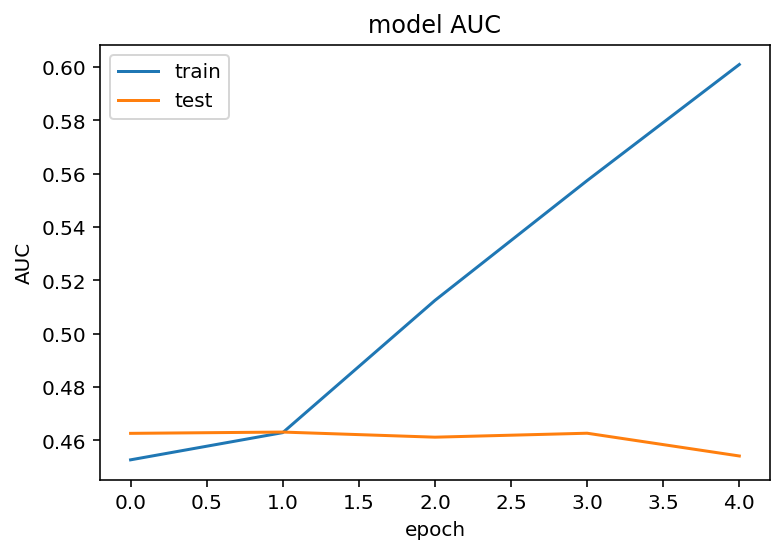

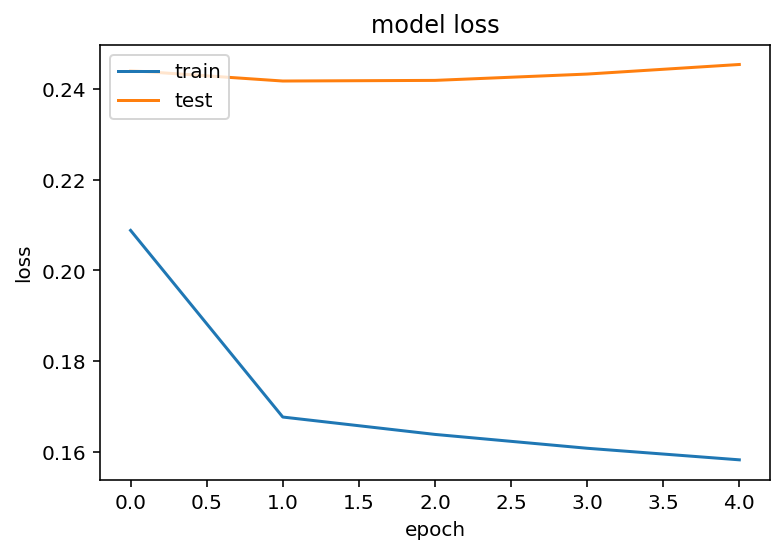

In [195]:
# list all data in history
print(history.history.keys())

# summarize history for accuracy
plt.plot(history.history['auc'])
plt.plot(history.history['val_auc'])
plt.title('model AUC')
plt.ylabel('AUC')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

## Визуализация предсказаний

In [196]:
import plotly.graph_objects as go
import plotly.express as px

config = dict({'scrollZoom': True})

import pandas as pd
sens_name_1 = Data.columns[12]
sens_name_2 = Data.columns[13]

Sens_1 = Data[sens_name_1].values
Sens_2 = Data[sens_name_2].values

Target = Data.target.values * max(Sens_1.max(), Sens_2.max())
Shifted_Target = Data.shift_target.values * max(Sens_1.max(), Sens_2.max())
Target_DSCR = Data.target_dscr.values

# TrainPreds = model.predict(X_train)[:,0] * max(Sens_1.max(), Sens_2.max())
# TestPreds = model.predict(X_test)[:,0] * max(Sens_1.max(), Sens_2.max())
Preds = model.predict(X_to_vis)[:,0] * max(Sens_1.max(), Sens_2.max())

fig = go.Figure()
fig.add_trace(go.Scatter(x=Data.index, y=Sens_1, name="Вибрация ЗПД (осев.)"))
fig.add_trace(go.Scatter(x=Data.index, y=Sens_2, name="Вибрация ЗПД (рад.)"))

fig.add_trace(go.Scatter(x=Data.index, y=Target, text=Target_DSCR, name="Остановки"))
fig.add_trace(go.Scatter(x=Data.index, y=Shifted_Target, text=Target_DSCR, name="Target"))

# fig.add_trace(go.Scatter(x=Data.index[:len(TrainPreds)], y=TrainPreds,  name="Train Preds"))
# fig.add_trace(go.Scatter(x=Data.index[len(TrainPreds):], y=TestPreds,  name="Test Preds"))
fig.add_trace(go.Scatter(x=Data.index, y=Preds,  name="Preds"))

#==========================================================================================#

# fig.update_xaxes(rangeslider_visible=True)
fig.show(config=config)
# fig.write_html("March_Stops_Example.html", config=config)